<a href="https://colab.research.google.com/github/MichaelSeitz98/Seminararbeit/blob/main/Inferenzanwendung_Bild.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tensorflow OD API installieren


*   Listeneintrag
*   Listeneintrag



In [ ]:
# Meine GoogleDrive mounten

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Tensorflow installieren -> Dauer: circa 1 min
!pip install tensorflow=="2.6.0"

In [ ]:
import os
import pathlib

# Tensorflow models repository klonen, wenn es noch nicht vorhanden ist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

In [ ]:
# Installieren der Object Detection API 
# Kann bis zu 5 min dauern. 

%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

In [ ]:
#Tests durchlaufen lassen 
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py

# Modell & Labelmap laden

In [ ]:
# LabelMap von meinem GitHub-Account laden #TODO: Checken, ob schon vorhanden
%cd /content/

!wget https://raw.githubusercontent.com/MichaelSeitz98/Seminararbeit/main/labelmap.pbtxt

In [ ]:
# model_path = '/content/drive/MyDrive/training_effDet_d0_4_3000_100/inference_graph/'
# output_directory = '/content/drive/MyDrive/training_effDet_d0_4_3000_100/inference_graph'

labelmap_path = '/content/labelmap.pbtxt'


saved_model_dir = '/content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/inference_graph/saved_model'
speicherPfadEvalBilder = '/content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val'

input_bilder_pfad_train = '/content/drive/MyDrive/Data_Split_1_POOL_80_20_20/train'

input_bilder_pfad_val ='/content/drive/MyDrive/Data_Split_1_POOL_80_20_20/validation'
input_bilder_pfad_test ='/content/drive/MyDrive/Data_Split_1_POOL_80_20_20/test'

In [ ]:
# Alle benötigte packages für die Inferenz importiert

import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
from IPython.display import display

from six import BytesIO

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

%matplotlib inline

In [ ]:
# Methode um aus Image ein Numpy_array zu machen 

def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path (this can be local or on colossus)

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
# Label map Category Index erzeugen
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)

print(f'Catergory Index erzeugt aus LabelMap: {labelmap_path}')

Catergory Index erzeugt aus LabelMap: /content/labelmap.pbtxt


In [ ]:
# Hier das Modell reinladen: TODO: als einen SavelModellPath reingeben
tf.keras.backend.clear_session()
model = tf.saved_model.load(saved_model_dir)

print(f'Trainiertes Model erfolgreich geladen von: {saved_model_dir}')


Trained model erfolgreich geladen von: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/inference_graph/saved_model


In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

In [ ]:
#Erzeugen eines neuen Ordners -> mit den richtigen geboxten Bilder 

# prüfen, ob schon ein Output-Folder für die Bilder vorhanden.
if (not os.path.isdir(speicherPfadEvalBilder)): 
    %mkdir {speicherPfadEvalBilder}
    print(f'Ordner erzeugt: {speicherPfadEvalBilder}')
else:    print(f'Ordner: {speicherPfadEvalBilder} existiert schon')

aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/Download.jpg


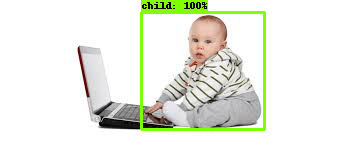

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/Download.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images.jpg


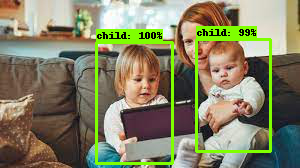

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (1).jpg


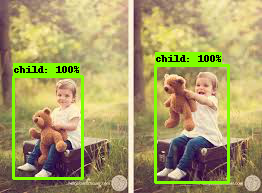

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (1).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (2).jpg


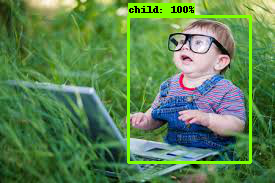

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (2).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (3).jpg


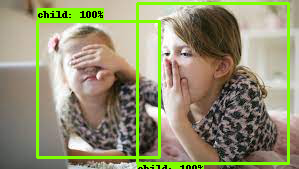

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (3).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (4).jpg


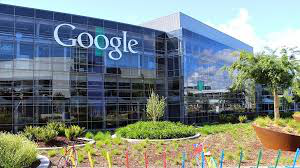

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (4).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (5).jpg


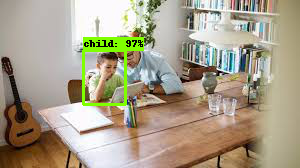

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (5).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/Download (1).jpg


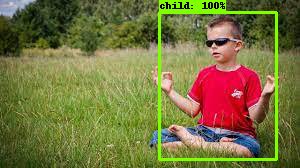

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/Download (1).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/Download (2).jpg


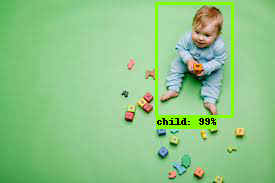

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/Download (2).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/toy_models.jpg


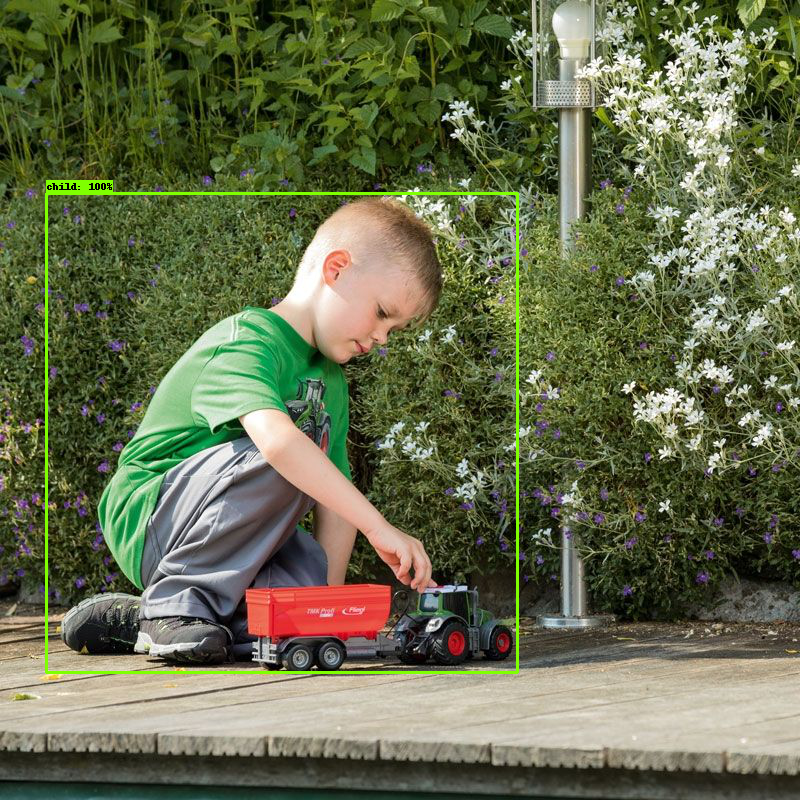

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/toy_models.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (6).jpg


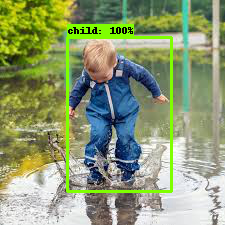

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (6).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (7).jpg


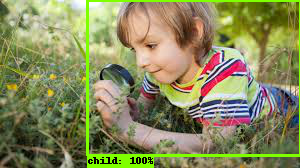

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (7).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (8).jpg


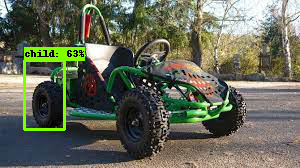

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (8).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (9).jpg


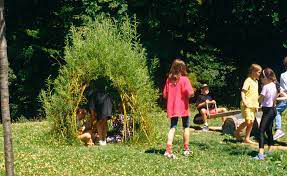

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (9).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (10).jpg


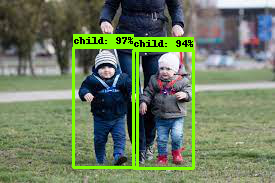

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (10).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (11).jpg


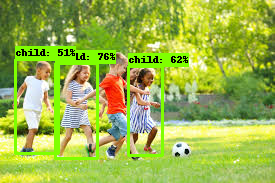

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (11).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (12).jpg


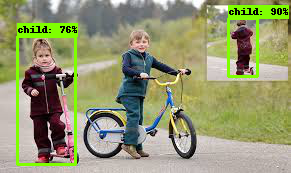

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (12).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (13).jpg


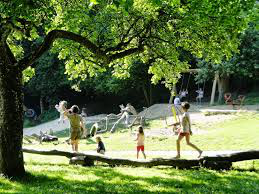

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (13).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/images (14).jpg


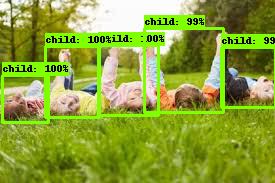

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/images (14).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/Download15.jpg


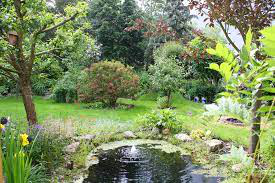

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/Download15.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/Download (3).jpg


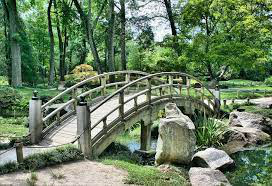

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/Download (3).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/Download_teich.jpg


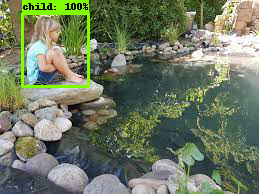

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/Download_teich.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-ga47cf7943_1920.jpg


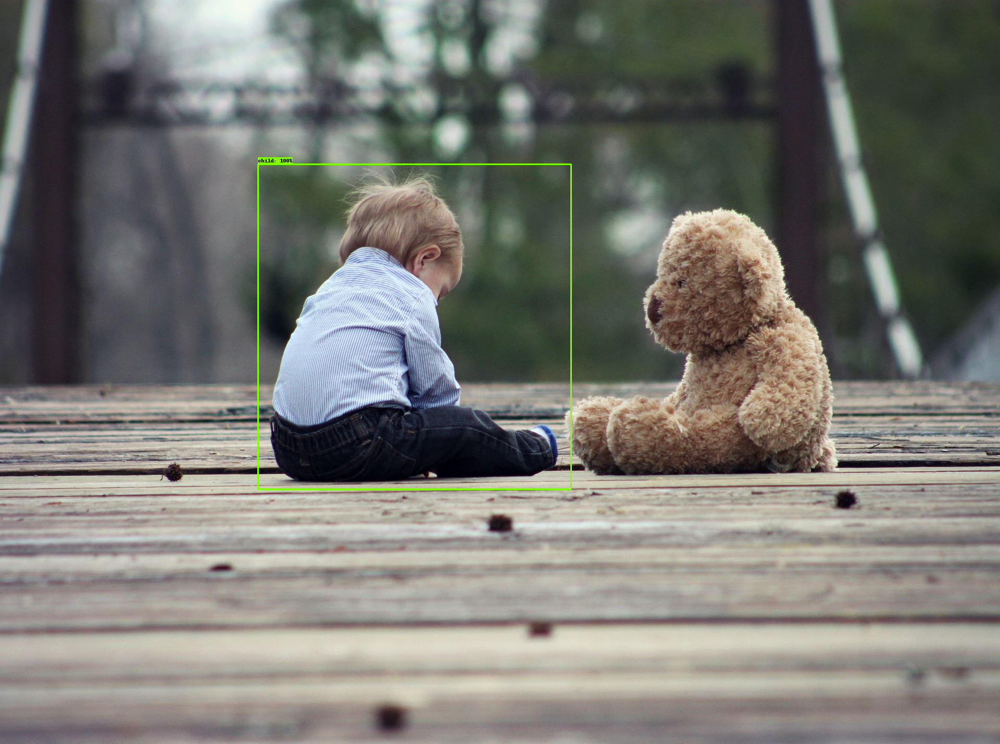

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-ga47cf7943_1920.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/girl-447701__480.jpg


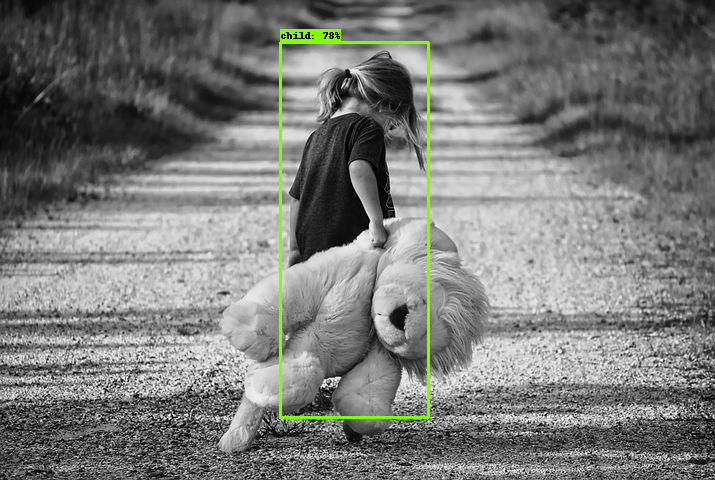

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/girl-447701__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/photographer-920128__480.jpg


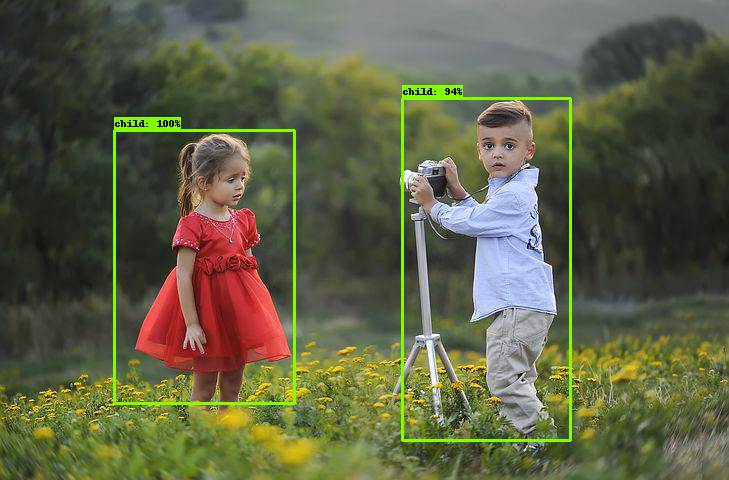

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/photographer-920128__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/girl-3402351__480.jpg


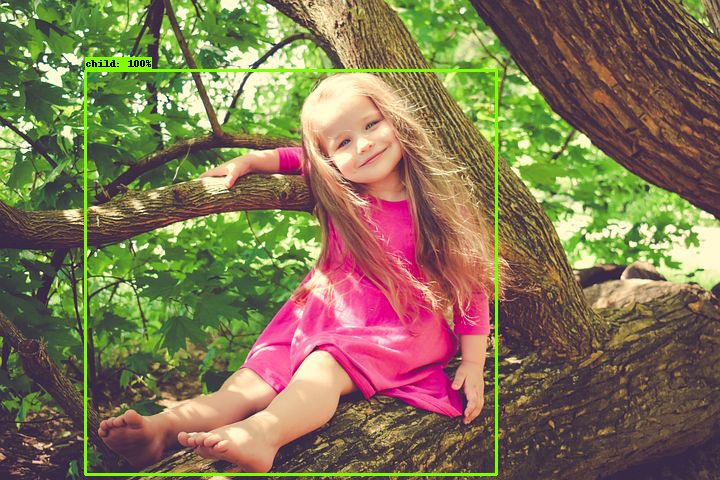

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/girl-3402351__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/girl-529013__480.jpg


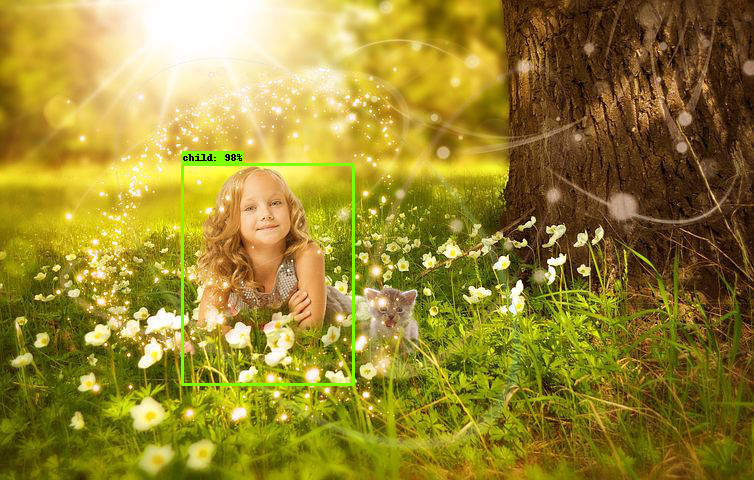

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/girl-529013__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-390555__480.jpg


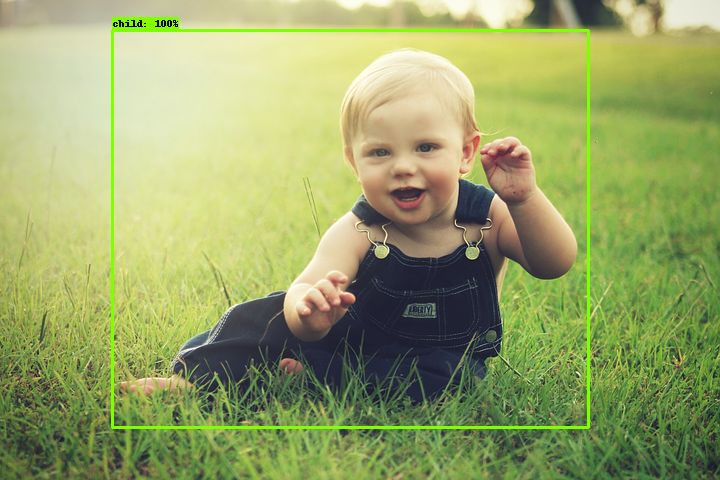

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-390555__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-1426651__480.jpg


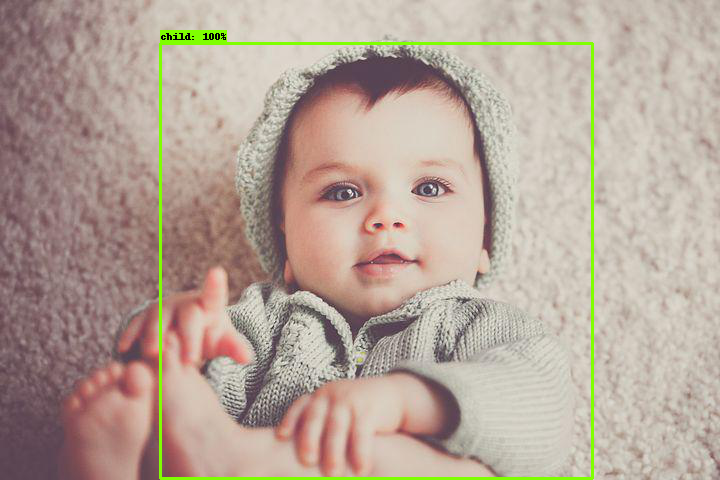

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-1426651__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-1440526__480.jpg


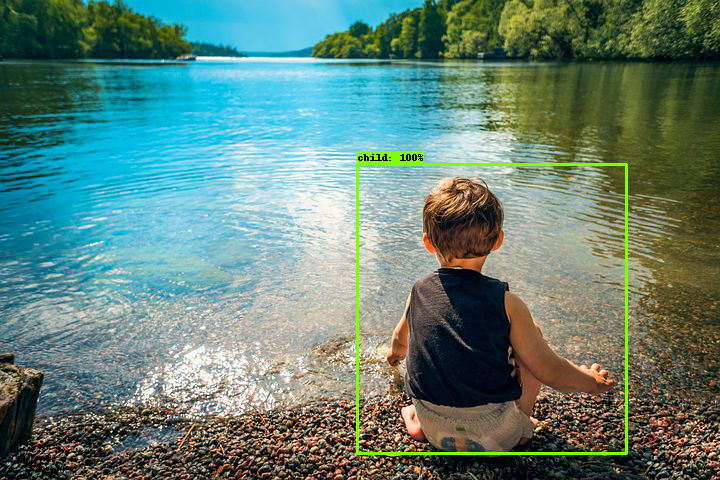

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-1440526__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/music-818459__480.jpg


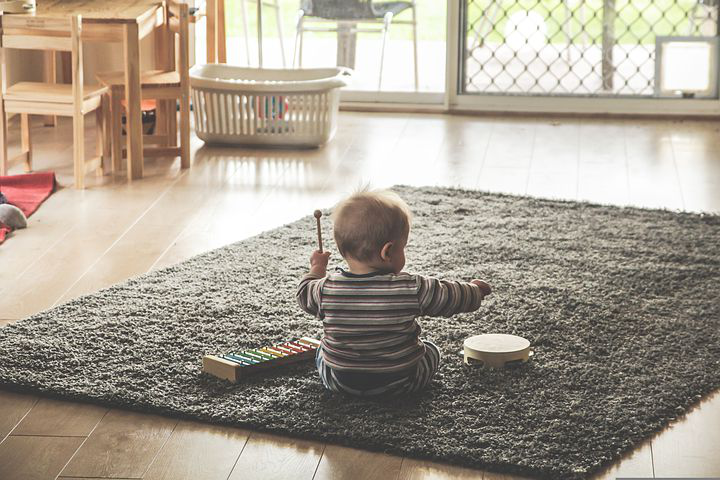

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/music-818459__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/girl-1357485__480.jpg


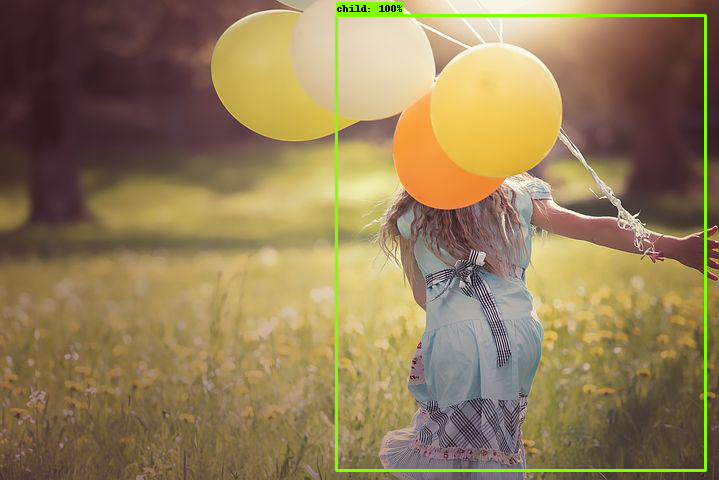

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/girl-1357485__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/people-1560569__480.jpg


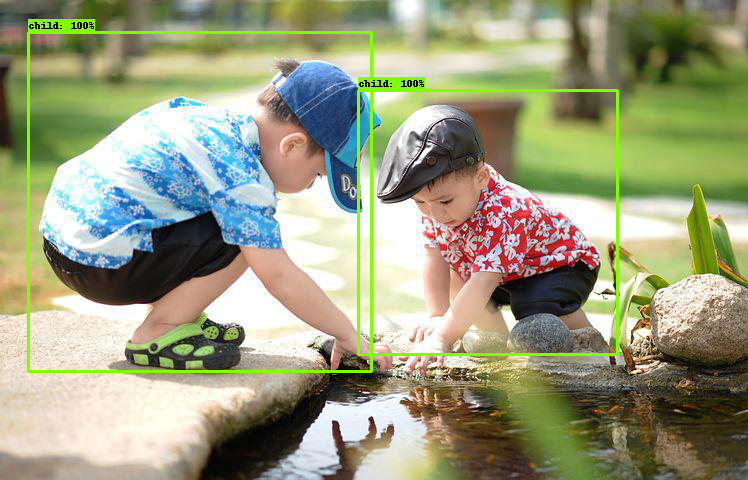

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/people-1560569__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/family-3602245__480.jpg


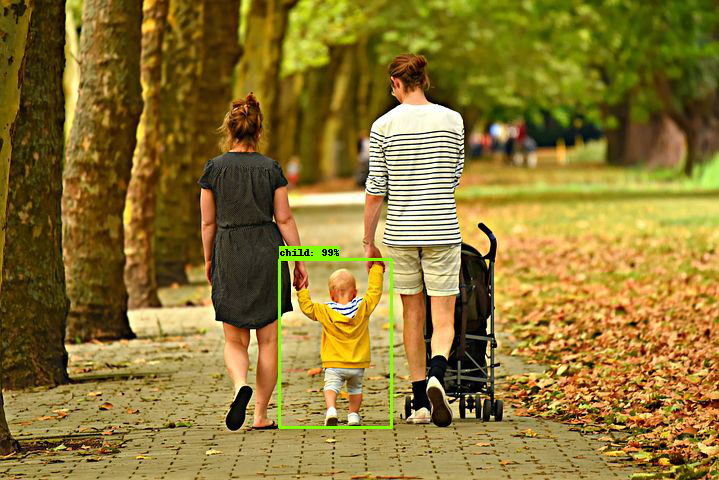

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/family-3602245__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/person-822803__480.jpg


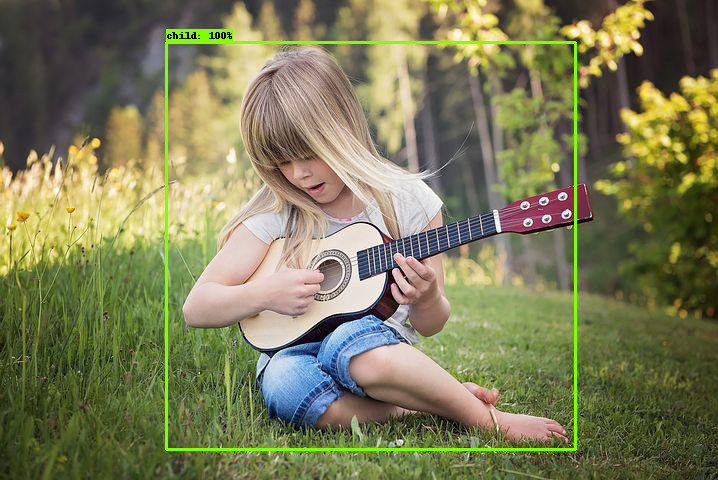

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/person-822803__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/youth-640094__480.jpg


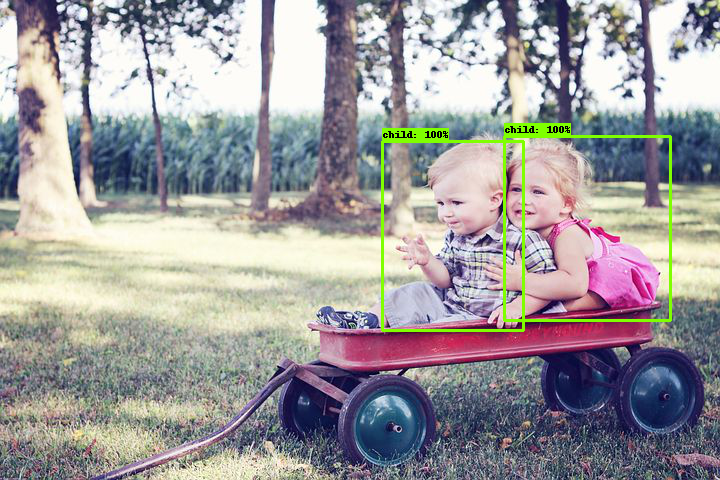

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/youth-640094__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-5271290__480.jpg


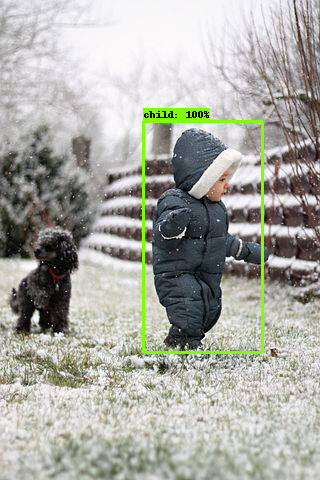

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-5271290__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-1867463__480.jpg


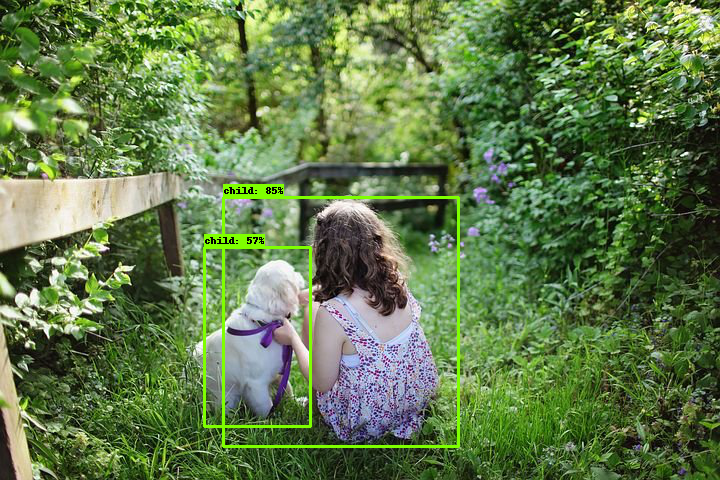

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-1867463__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-21971__480.jpg


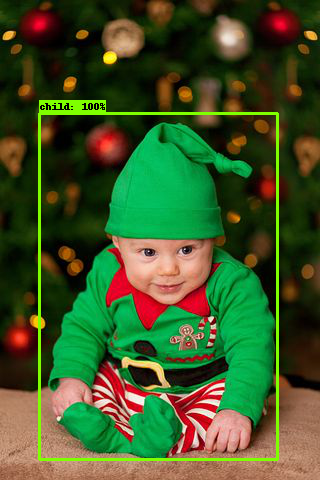

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-21971__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-463558__480.jpg


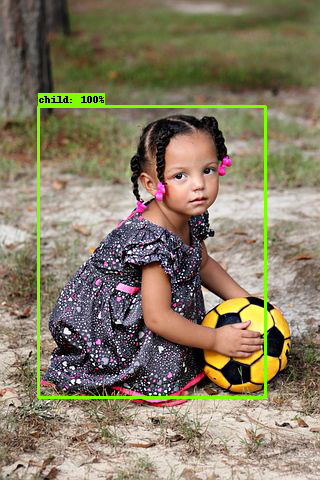

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-463558__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/puddle-2863648__480.jpg


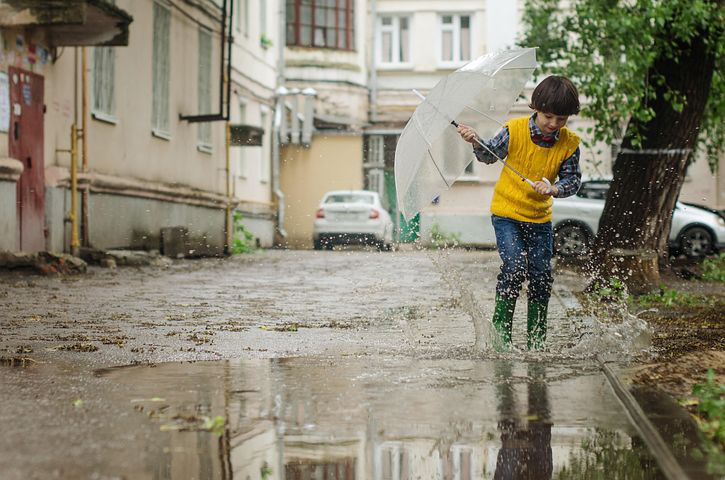

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/puddle-2863648__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-1868683__480.jpg


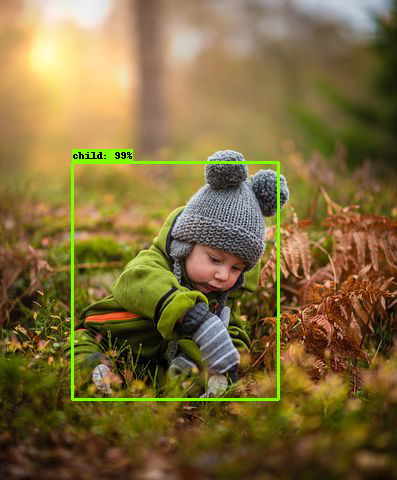

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-1868683__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/girl-3559538__480.jpg


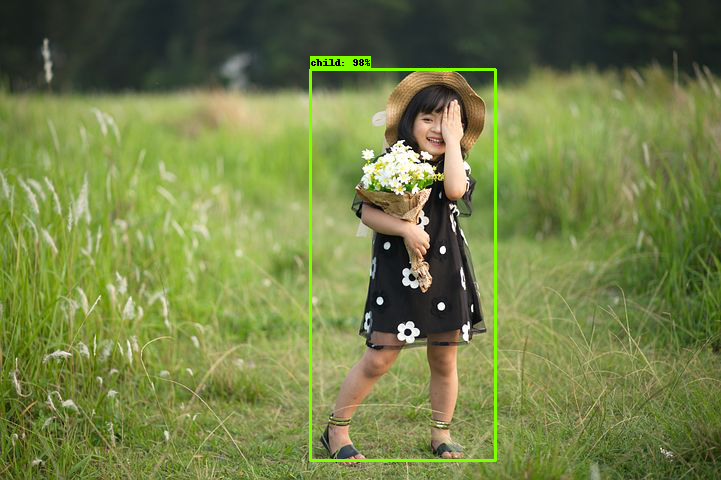

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/girl-3559538__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/boy-746520__480.jpg


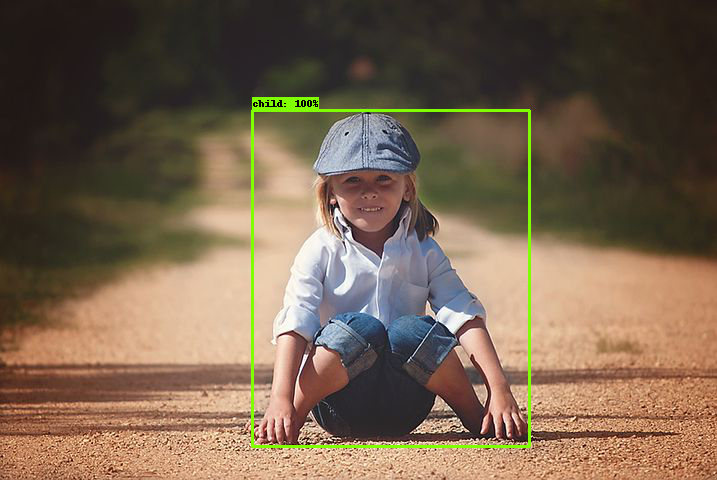

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/boy-746520__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-4116187__480.jpg


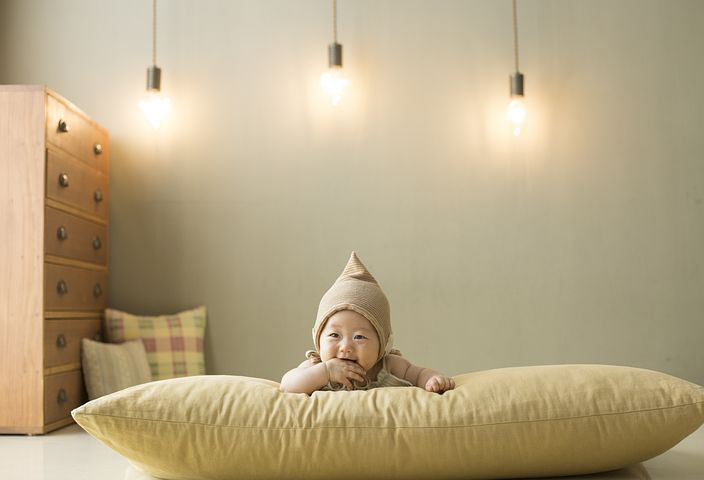

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-4116187__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-1347388__480.jpg


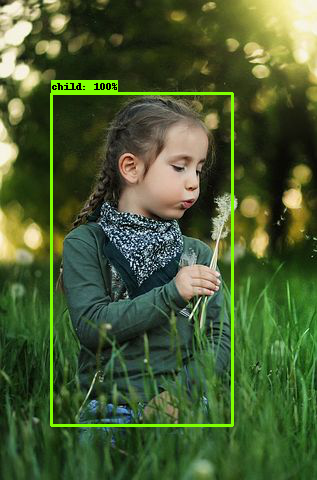

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-1347388__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-5953965__480.jpg


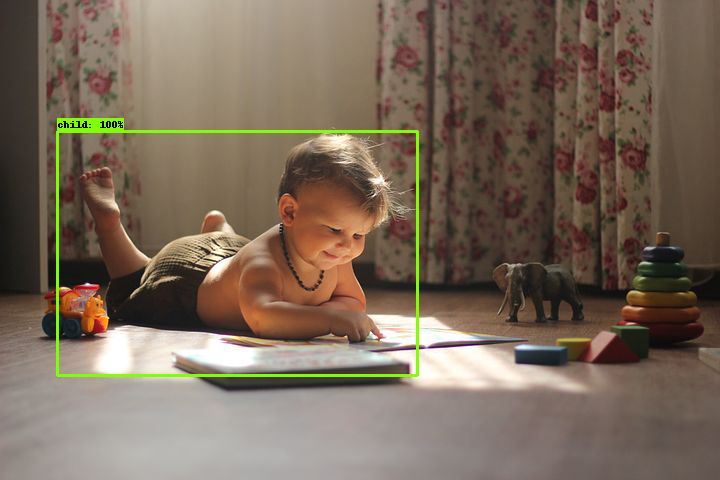

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-5953965__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-5489290__480.jpg


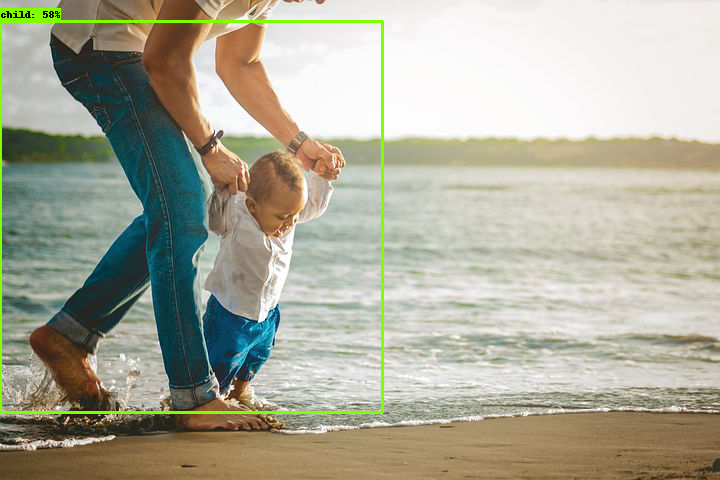

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-5489290__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-1868518__480.jpg


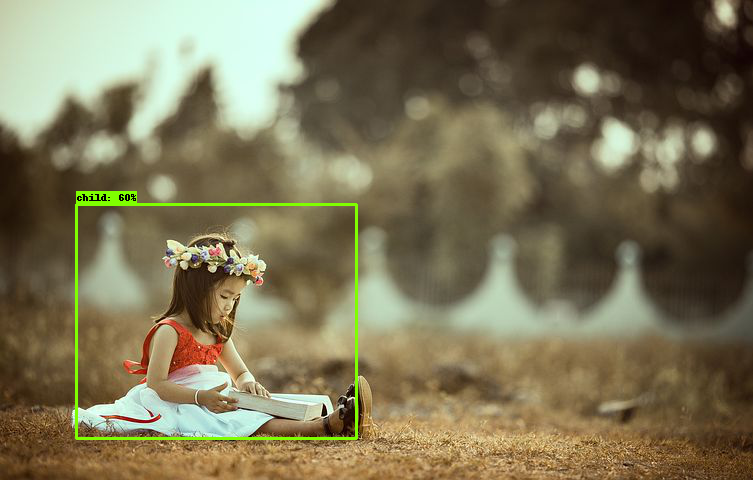

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-1868518__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-1347388__480 (1).jpg


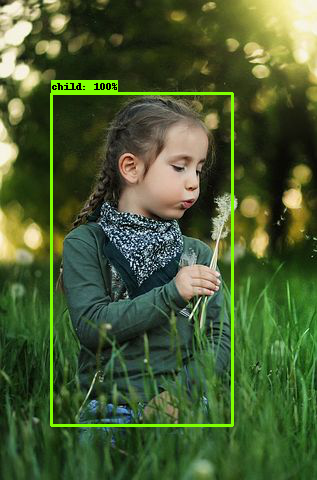

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-1347388__480 (1).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-5953965__480 (1).jpg


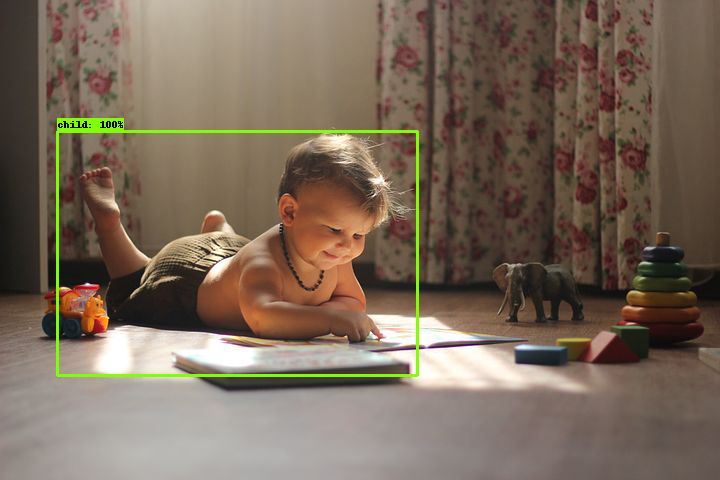

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-5953965__480 (1).jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-5446839__480.jpg


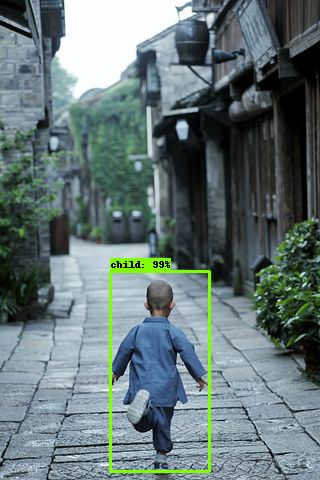

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-5446839__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/alone-1867464__480.jpg


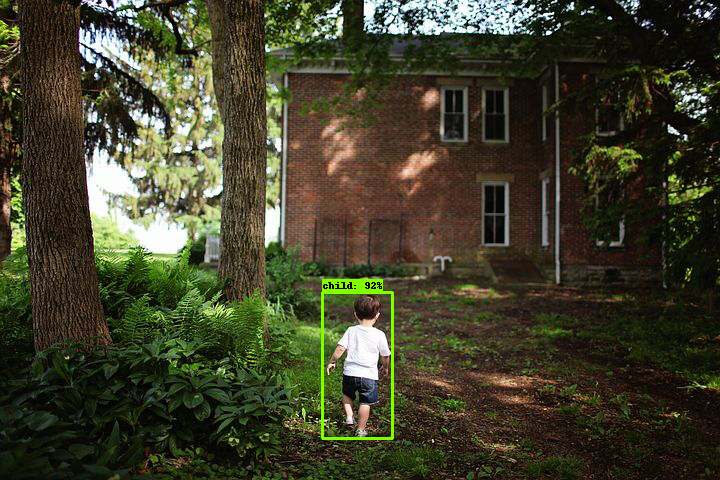

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/alone-1867464__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-5316045__480.jpg


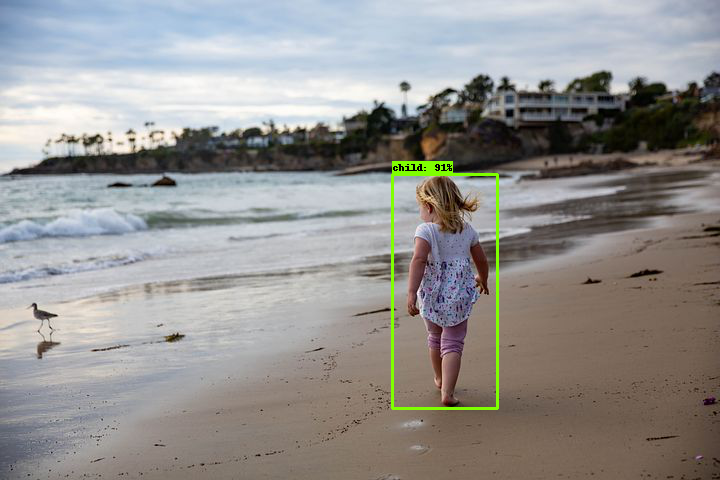

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-5316045__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/beach-5967650__480.jpg


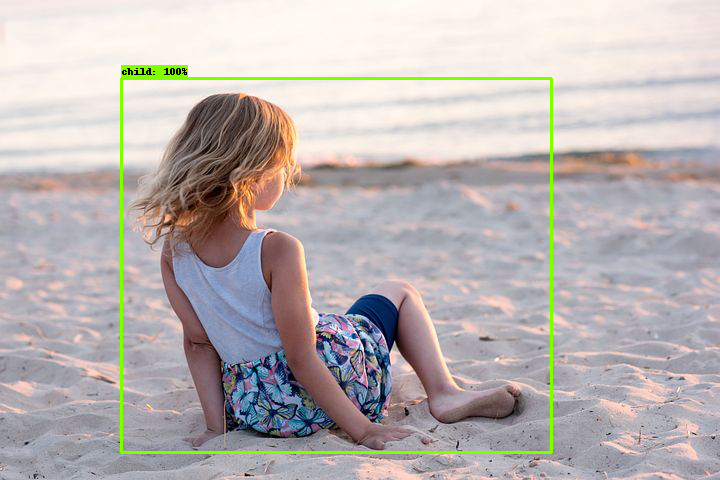

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/beach-5967650__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-7070570__480.jpg


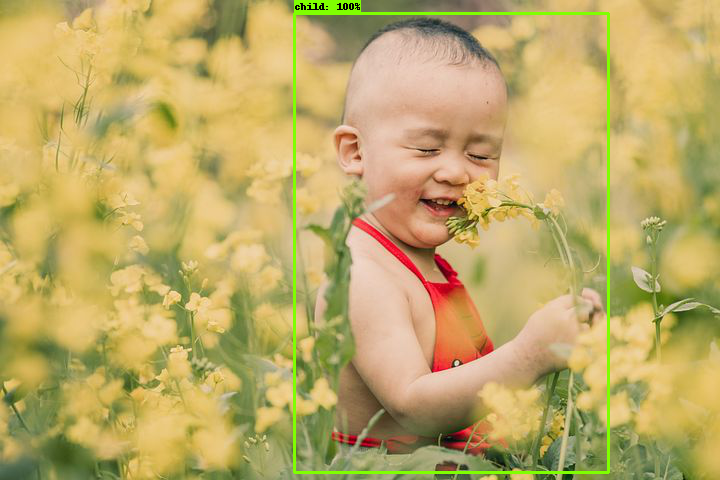

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-7070570__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-5582986__480.jpg


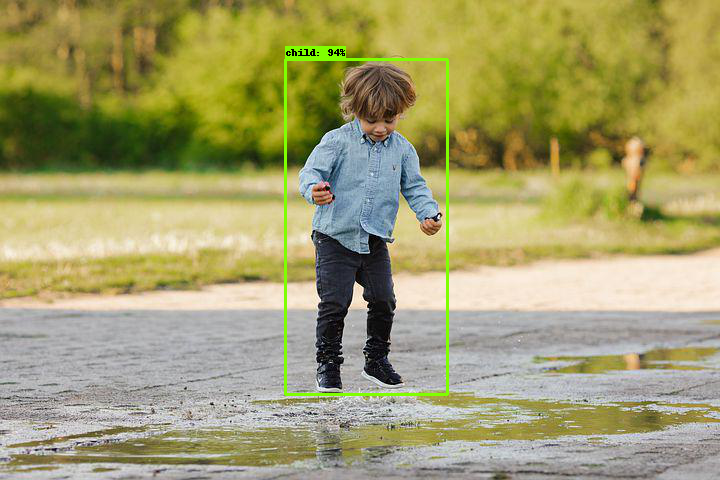

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-5582986__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/boy-6158164__480.jpg


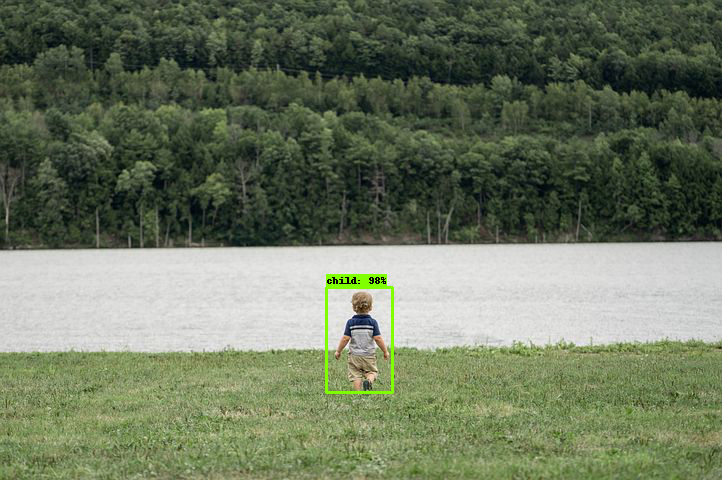

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/boy-6158164__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/wave-5255593__480.jpg


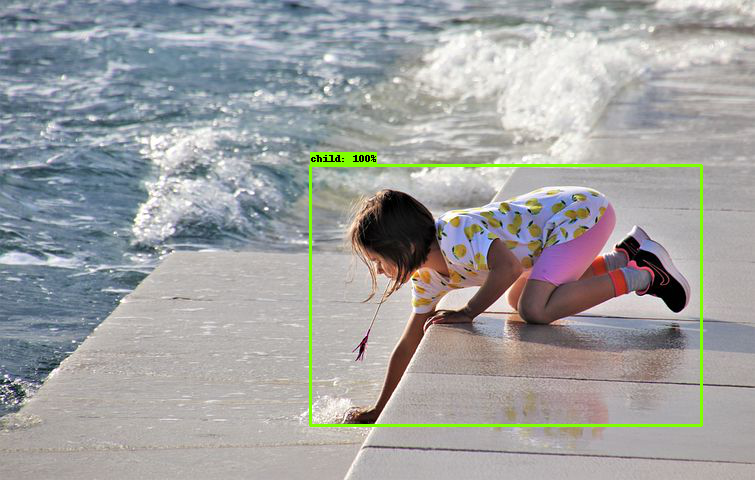

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/wave-5255593__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-817364__480.jpg


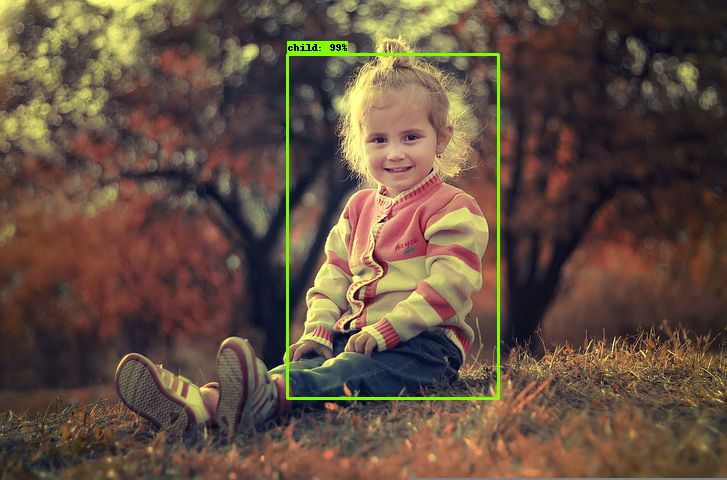

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-817364__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-6276604__480.jpg


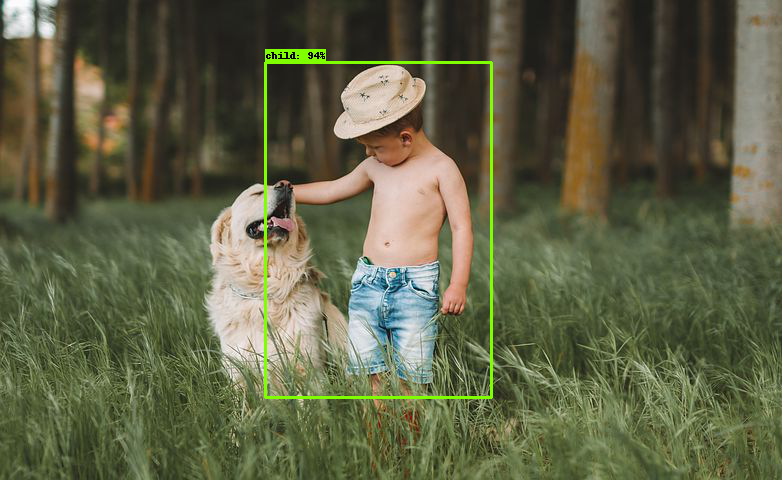

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-6276604__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/easter-4119709__480.jpg


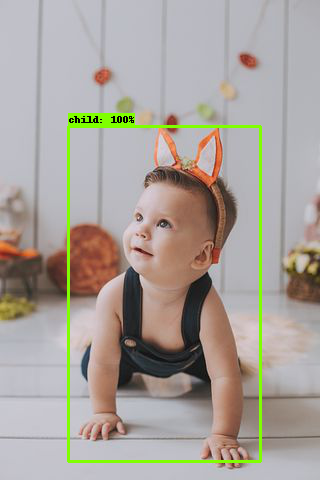

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/easter-4119709__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-7388054__480.jpg


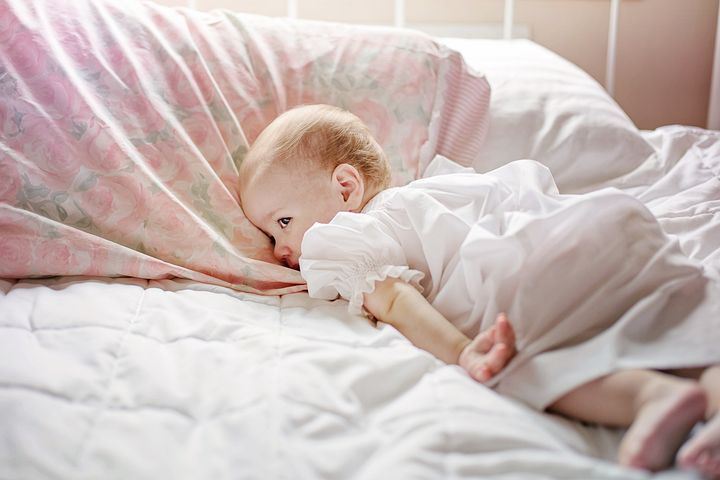

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-7388054__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/newborn-5036843__480.jpg


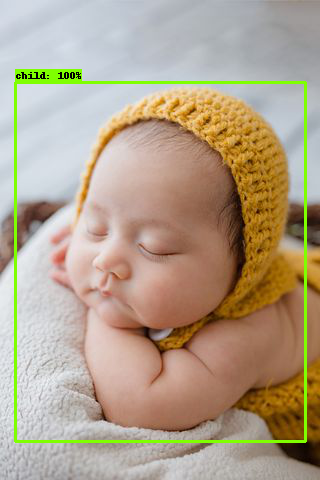

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/newborn-5036843__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/little-girl-4264929__480.jpg


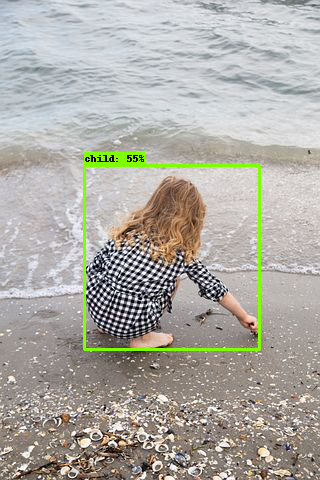

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/little-girl-4264929__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/boy-6112145__480.jpg


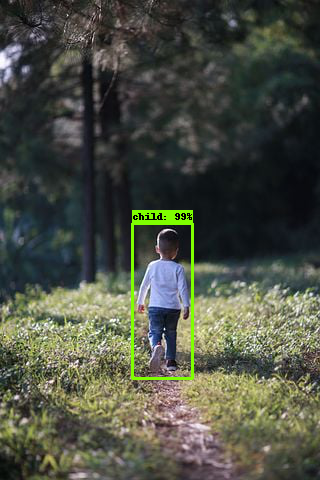

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/boy-6112145__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/kid-6289638__480.jpg


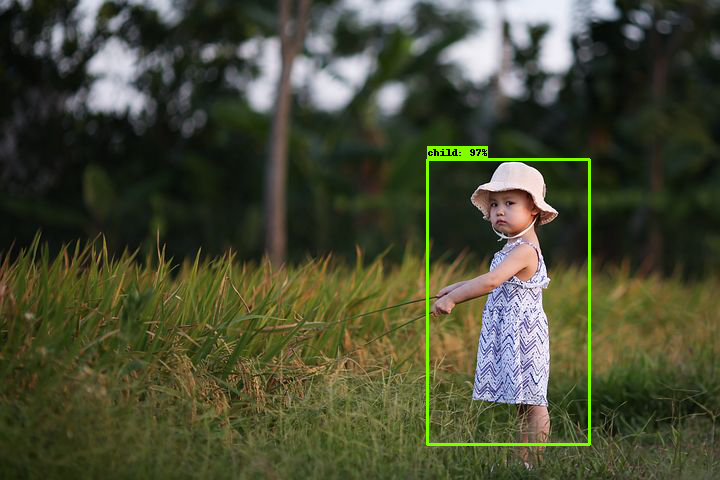

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/kid-6289638__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-3268264__480.jpg


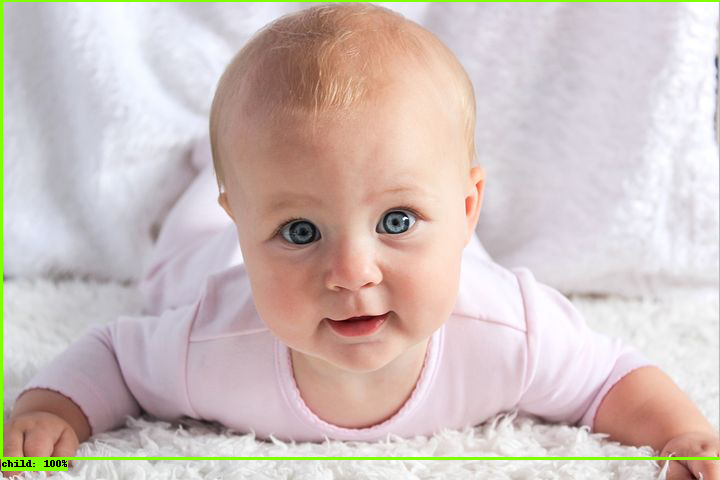

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-3268264__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-84552__480.jpg


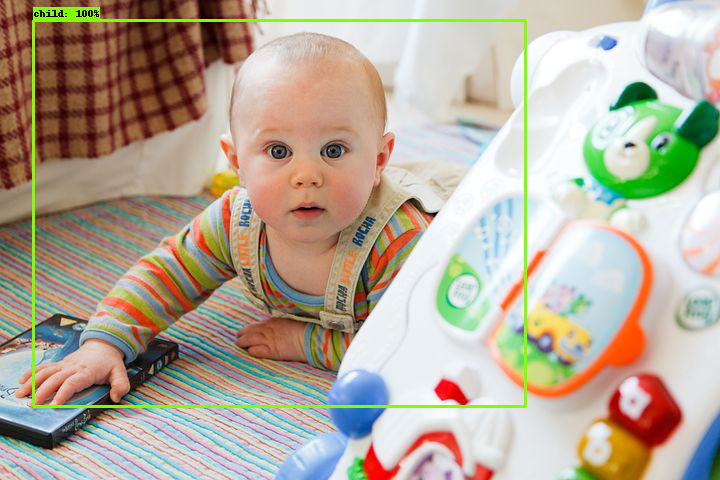

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-84552__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/babe-2972220__480.jpg


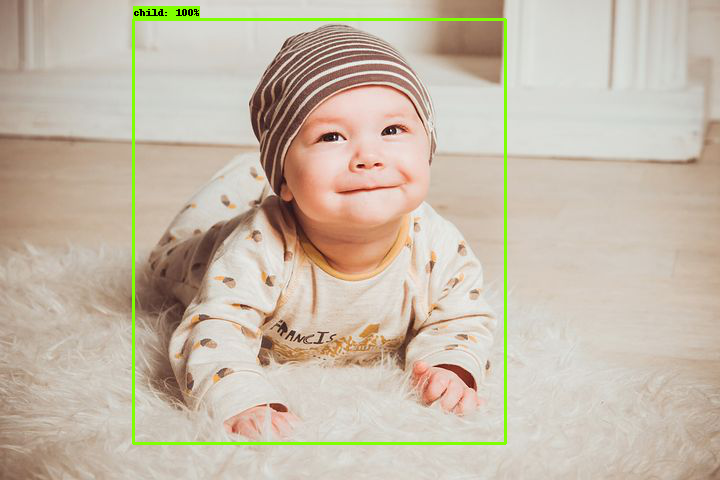

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/babe-2972220__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/childrens-1256840__480.jpg


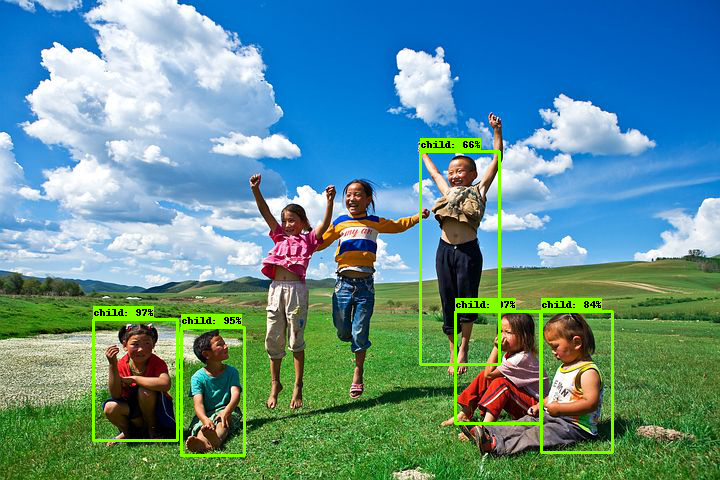

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/childrens-1256840__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-2916824__480.jpg


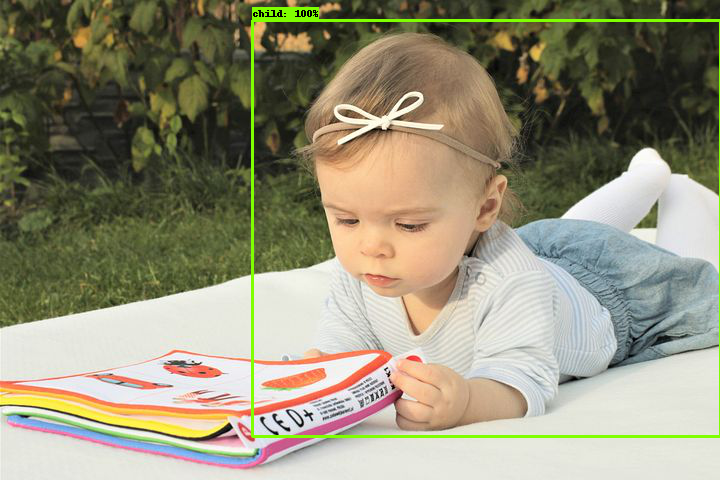

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-2916824__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-1997729__480.jpg


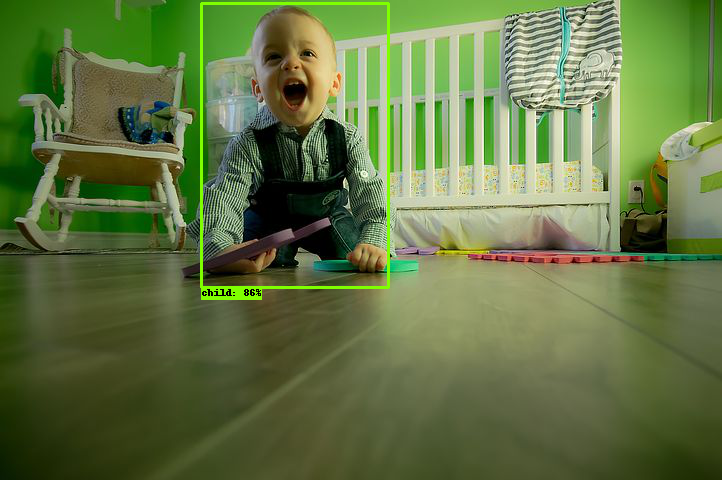

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-1997729__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-1262817__480.jpg


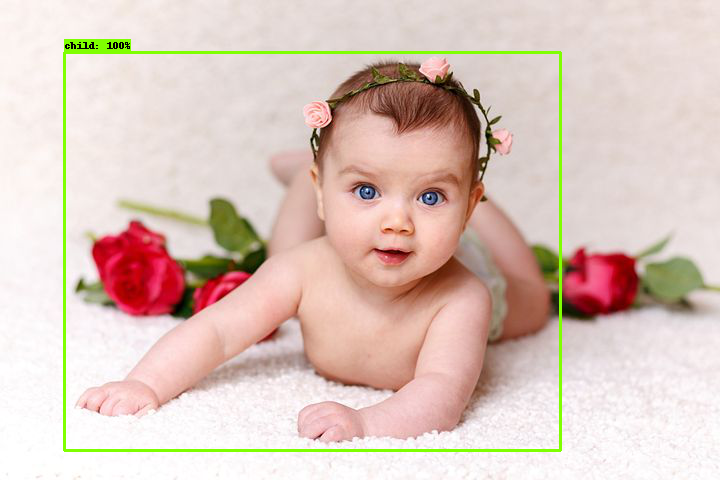

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-1262817__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/kid-1493932__480.jpg


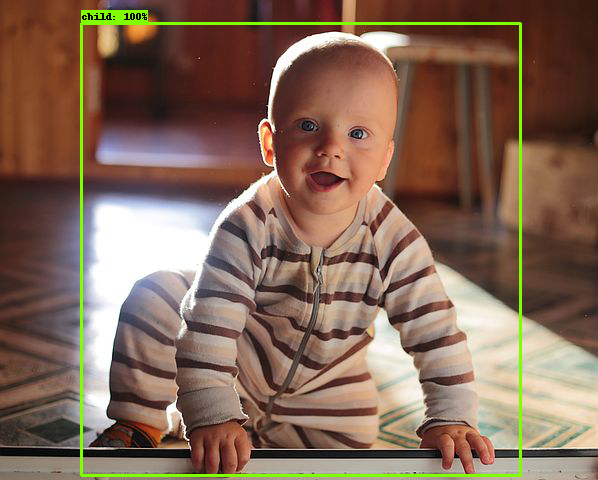

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/kid-1493932__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/person-987557__480.jpg


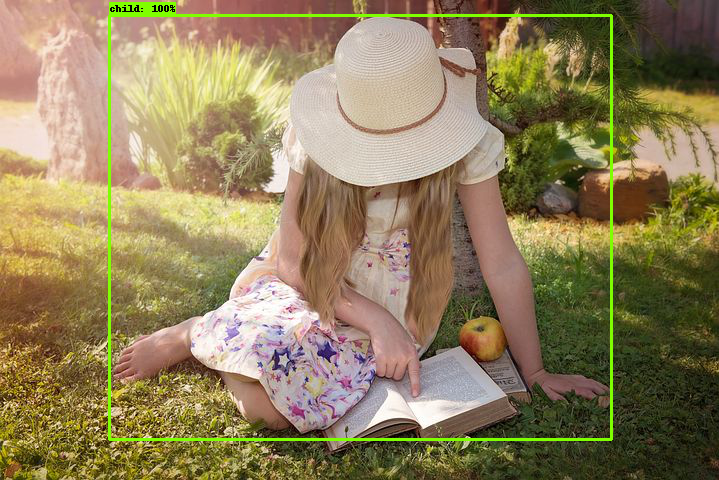

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/person-987557__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-316211__480.jpg


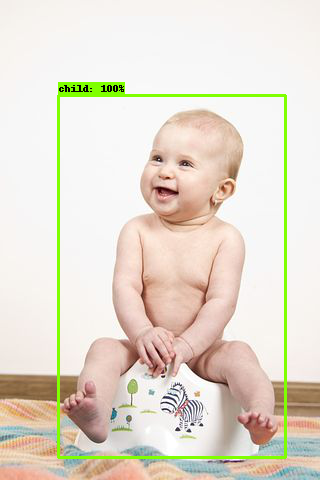

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-316211__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/newborn-2186599__480.jpg


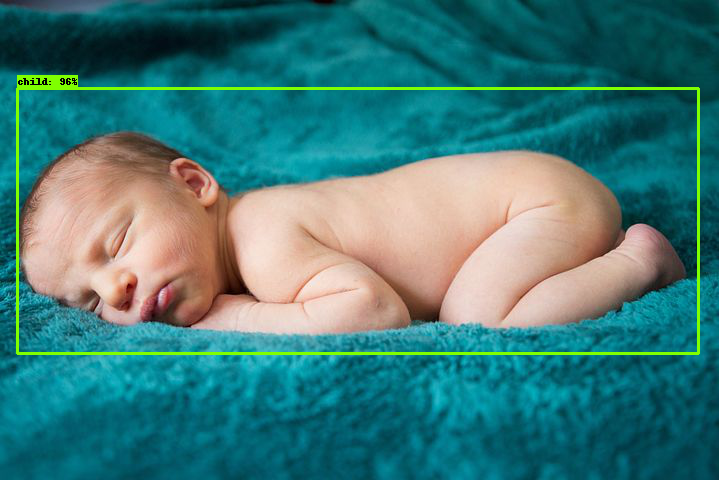

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/newborn-2186599__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-1636317__480.jpg


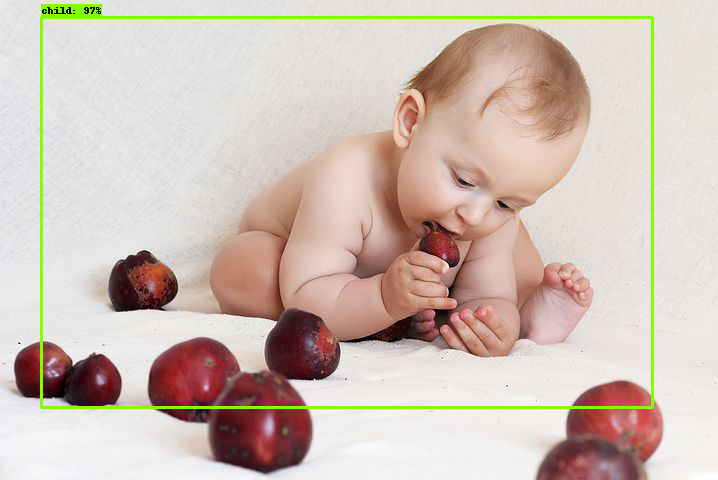

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-1636317__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/surfing-1990339__480.jpg


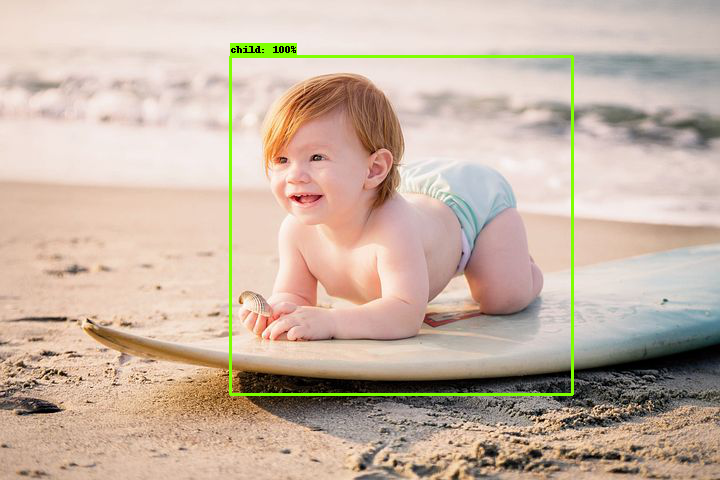

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/surfing-1990339__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/baby-3092097__480.jpg


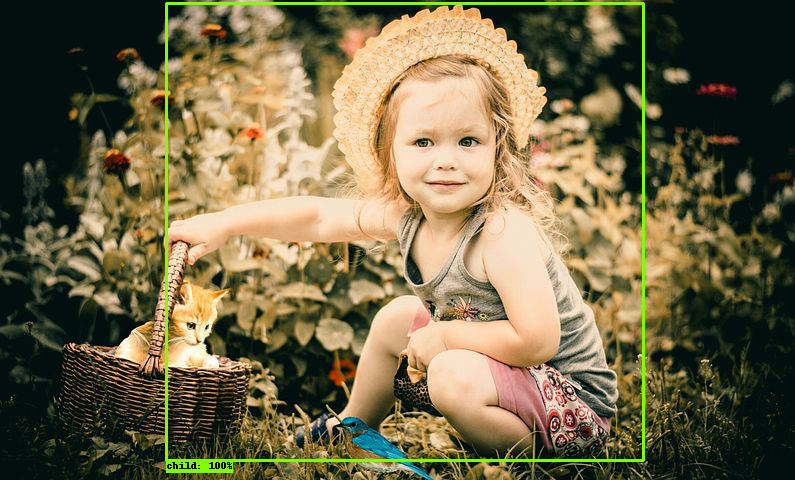

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/baby-3092097__480.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/160509_Starke-Baumtypen_Eiche-im-Seidengewand_02.jpg


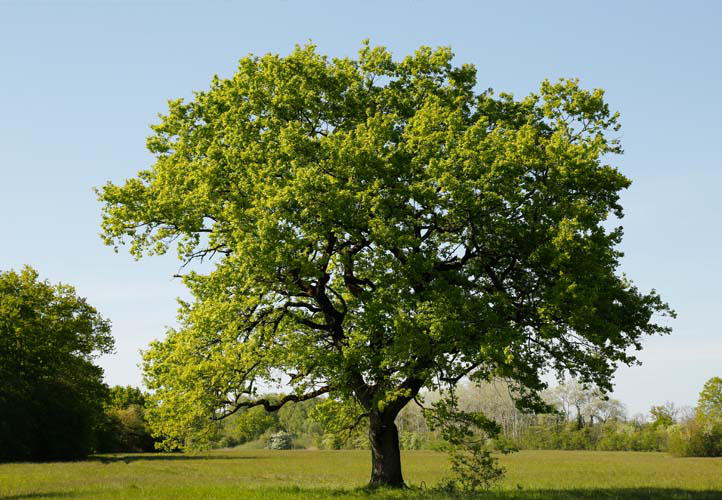

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/160509_Starke-Baumtypen_Eiche-im-Seidengewand_02.jpg_boxed.jpg
aktueller image_path:/content/drive/MyDrive/Child_Dataset/testEval/child-355176__480.jpg


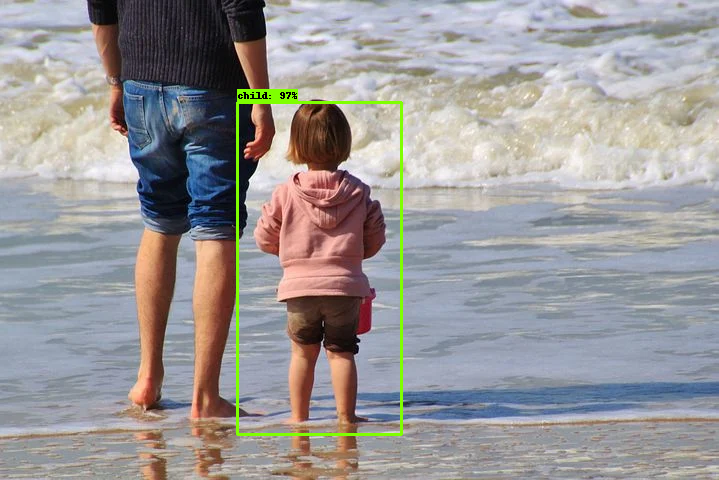

Hier gespeichert: /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val/child-355176__480.jpg_boxed.jpg
Fertig! Modell auf 83 Bilder angewendet und unter /content/drive/MyDrive/training_ssdMobileNetv2_ds1_8_20000_100/angewendeteBilder_val gespeichert.


In [ ]:
# Ab hier geht dann die Erkennung los: jedes Bild aus Test-Eval-Ordner wird untersucht und in den SpeicherPfadEvalBilder abgespeichert. 

bilderCounter = 0


# for image_path in glob.glob(f'{input_bilder_pfad_val}/*.jpeg'):
for image_path in glob.glob('/content/drive/MyDrive/Child_Dataset/testEval/*.jpg'):
  print(f'aktueller image_path:{image_path}')
  bilderCounter+=1
  image_name = os.path.basename(image_path).replace(".jpeg", "")
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model, image_np)
  outImg = vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      min_score_thresh=0.50,
      max_boxes_to_draw=15,
      line_thickness=3)
  
  im = Image.fromarray(outImg)
  display(Image.fromarray(image_np))
  print ('Hier gespeichert: ' + speicherPfadEvalBilder + "/" + image_name + "_boxed.jpg")
  im.save(speicherPfadEvalBilder + "/testEvalGroß/" + image_name + "_boxed.jpg")


print(f'Fertig! Modell auf {bilderCounter} Bilder angewendet und unter {speicherPfadEvalBilder} gespeichert.')

In [ ]:
# Versuch für Val die Metriken zu ziehen mit dem letzten Checkpoint 

# alternativ eine test.record am ende erzeugen und damit auch die Test metric bekommen

model_dir = 

!python /content/models/research/object_detection/model_main_tf2.py \
    --model_dir={saved_model_dir} \
    --pipeline_config_path={pipeline_config_path} \
    --num_eval_steps={num_eval_steps} \ #bringt das was für den Verlauf?
    --checkpoint_dir={model_dir}